In [1]:
%pylab inline
import time
import os 
image_dir = './Images/'
model_dir = './'

import torch
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F
from torch import optim

import torchvision
from torchvision import transforms

from PIL import Image
from collections import OrderedDict
import cv2
from torchvision import models
import gc
gc.collect()

import matplotlib.pyplot as plt
import numpy as np
# from nnabla.utils.image_utils import imread

import matplotlib.pyplot
from skimage.data import astronaut
from skimage.color import rgb2gray
from skimage.filters import sobel
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from PIL import Image
from skimage.io import imread

Populating the interactive namespace from numpy and matplotlib


In [2]:
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

In [3]:
#vgg definition that conveniently let's you grab the outputs from any layer
class VGG(nn.Module):
    def __init__(self, pool='max'):
        super(VGG, self).__init__()
        #vgg modules
        self.conv1_1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.conv1_2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.conv2_1 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.conv2_2 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.conv3_1 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.conv3_2 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv3_3 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv3_4 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv4_1 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.conv4_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv4_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv4_4 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_1 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_4 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        if pool == 'max':
            self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool5 = nn.MaxPool2d(kernel_size=2, stride=2)
        elif pool == 'avg':
            self.pool1 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool2 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool3 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool4 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool5 = nn.AvgPool2d(kernel_size=2, stride=2)
            
    def forward(self, x, out_keys):
        out = {}
        out['r11'] = F.relu(self.conv1_1(x))
        out['r12'] = F.relu(self.conv1_2(out['r11']))
        out['p1'] = self.pool1(out['r12'])
        out['r21'] = F.relu(self.conv2_1(out['p1']))
        out['r22'] = F.relu(self.conv2_2(out['r21']))
        out['p2'] = self.pool2(out['r22'])
        out['r31'] = F.relu(self.conv3_1(out['p2']))
        out['r32'] = F.relu(self.conv3_2(out['r31']))
        out['r33'] = F.relu(self.conv3_3(out['r32']))
        out['r34'] = F.relu(self.conv3_4(out['r33']))
        out['p3'] = self.pool3(out['r34'])
        out['r41'] = F.relu(self.conv4_1(out['p3']))
        out['r42'] = F.relu(self.conv4_2(out['r41']))
        out['r43'] = F.relu(self.conv4_3(out['r42']))
        out['r44'] = F.relu(self.conv4_4(out['r43']))
        out['p4'] = self.pool4(out['r44'])
        out['r51'] = F.relu(self.conv5_1(out['p4']))
        out['r52'] = F.relu(self.conv5_2(out['r51']))
        out['r53'] = F.relu(self.conv5_3(out['r52']))
        out['r54'] = F.relu(self.conv5_4(out['r53']))
        out['p5'] = self.pool5(out['r54'])
        return [out[key] for key in out_keys]

In [4]:
def get_style_mask(image_):
    masks_st = []
    image = imread(image_)
    img = img_as_float(image[::2, ::2])

    # segments_fz = felzenszwalb(img, scale=100, sigma=0.5, min_size=50)
    n_seg = 3
    segments_slic_10 = None
    for i in range(n_seg,25):
        n_seg = i
        segments_slic_10 = slic(img, n_segments=n_seg, compactness=1,  sigma=10,enforce_connectivity=True,
                         start_label=1)
#         print(np.unique(segments_slic_10).shape[0])
        if np.unique(segments_slic_10).shape[0]>3:
            break
    unique = np.unique(segments_slic_10)
    for i in range(unique.shape[0]):
        mask = np.zeros((segments_slic_10.shape[0],segments_slic_10.shape[1]), dtype=int)
        m = np.where(segments_slic_10==unique[i])
        mask[m] = 1
        mask = torch.from_numpy(mask).unsqueeze(0)
        masks_st.append(mask)
    masks_st.sort(key=compare)
    masks_st = masks_st[::-1]    
    return masks_st

In [5]:
def compare(item1):
    return item1[item1==1].sum()
# list_.sort(key=compare)

In [6]:
imgs = ["./Images/Styles/stone_pattern.jpg","./Images/Styles/5.jpg",
       "./Images/Styles/african_art.jpg","./Images/Styles/1e47ae67b133dc5d57b2e88217f82909.jpg"]
style_masks_all = []
for image_ in imgs:
    print(image_)
    style_masks = get_style_mask(image_)
    style_masks_all.append(style_masks)

./Images/Styles/stone_pattern.jpg
./Images/Styles/5.jpg
./Images/Styles/african_art.jpg
./Images/Styles/1e47ae67b133dc5d57b2e88217f82909.jpg


In [7]:
def get_content_mask(img_path):
    masks = []
    dlab = models.segmentation.deeplabv3_resnet101(pretrained=1).eval()
    img = Image.open(img_path)
    a = cv2.imread(img_path)
    
    trf = torchvision.transforms.Compose([torchvision.transforms.Resize(512),
                     torchvision.transforms.ToTensor(), 
                     torchvision.transforms.Normalize(mean = [0.485, 0.456, 0.406], 
                                 std = [0.229, 0.224, 0.225])])
    inp = trf(img).unsqueeze(0)
    out = dlab(inp)['out']
    om = torch.argmax(out.squeeze(), dim=0).detach().cpu().numpy()
    if img_path == './Images/Contents/4.jpg':
        a = cv2.imread('./out_4_4.png')
        gray = cv2.cvtColor(a, cv2.COLOR_BGR2GRAY)
        unique = np.unique(gray)
        mask = np.zeros((gray.shape[0],gray.shape[1]), dtype=int)
        m = np.where(gray==unique[0])
        mask[m] = 1
        mask = torch.from_numpy(mask).unsqueeze(0)
        masks.append(mask)
        mask = np.zeros((gray.shape[0],gray.shape[1]), dtype=int)
        m = np.where(gray==unique[-1])
        mask[m] = 1
        mask = torch.from_numpy(mask).unsqueeze(0)
        masks.append(mask)
        return masks
    
    om = om.astype(np.float32)
    unique = np.unique(om)
    for i in range(unique.shape[0]):
        mask = np.zeros((om.shape[0],om.shape[1]), dtype=int)
        m = np.where(om==unique[i])
        mask[m] = 1
        mask = torch.from_numpy(mask).unsqueeze(0)
        masks.append(mask)
    return(masks)

In [8]:
gc.collect()

21

In [9]:
def get_layers_masks(mask):
    r_avg = nn.AvgPool2d(3, 1, 1)
    r_max = nn.MaxPool2d(2,2)
    masks = []
    layer_mask = r_avg(mask)
    masks.append(layer_mask)
    layer_mask1 = r_avg(layer_mask)
    layer_mask1 = r_max(layer_mask1)

    layer_mask1 = r_avg(layer_mask1)
    masks.append(layer_mask1)
    layer_mask2 = r_avg(layer_mask1)
    layer_mask2 = r_max(layer_mask2)

    layer_mask2 = r_avg(layer_mask2)
    masks.append(layer_mask2)
    layer_mask3 = r_avg(layer_mask2)
    layer_mask3 = r_avg(layer_mask3)
    layer_mask3 = r_avg(layer_mask3)
    layer_mask3 = r_max(layer_mask3)

    layer_mask3 = r_avg(layer_mask3)
    masks.append(layer_mask3)
    layer_mask4 = r_avg(layer_mask3)
    layer_mask4 = r_avg(layer_mask4)
    layer_mask4 = r_avg(layer_mask4)
    layer_mask4 = r_max(layer_mask4)

    layer_mask4 = r_avg(layer_mask4)
    masks.append(layer_mask4)
    layer_mask5 = r_avg(layer_mask4)
    layer_mask5 = r_avg(layer_mask5)
    layer_mask5 = r_avg(layer_mask5)
    layer_mask5 = r_max(layer_mask5)
    return masks

In [10]:
def gram_m(f):
    b,c,h,w = f.size()
    F = f.view(b, c, h*w)
    G = torch.bmm(F, F.transpose(1,2)) 
    G.div_(h*w)
    return G

In [11]:
def distance_imgs_gram_cos(img_a,img_b,mask_a,mask_b,vgg):
    img_a = vgg(img_a, ['r51'])
    img_b = vgg(img_b, ['r51'])
    masked_input = torch.einsum('abcd,mcd->ambcd', [img_a[0], mask_a.cuda()])[0]
    masked_target = torch.einsum('abcd,mcd->ambcd', [img_b[0], mask_b.cuda()])[0]
    a = gram_m(masked_input).reshape(-1)
    b = gram_m(masked_target).reshape(-1)
    return distance.cosine(a.cpu().numpy(),b.cpu().numpy())

In [12]:
from scipy.spatial import distance
def distance_imgs_gram_mse(img_a,img_b,mask_a,mask_b,vgg):
    img_a = vgg(img_a, ['r51'])
    img_b = vgg(img_b, ['r51'])
    masked_input = torch.einsum('abcd,mcd->ambcd', [img_a[0], mask_a.cuda()])[0]
    masked_target = torch.einsum('abcd,mcd->ambcd', [img_b[0], mask_b.cuda()])[0]
    a = gram_m(masked_input)
    b = gram_m(masked_target)
    return ((a-b)**2).sum()

In [13]:
def distance_imgs_gram_mse_gray(img_a,img_b,mask_a,mask_b,vgg):
    img1 = img_a[0].to("cpu").numpy()
    img1 = img1.reshape((512,512,3))
    gray = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    img1 = np.zeros_like(img1)
    img1[:,:,0] = gray
    img1[:,:,1] = gray
    img1[:,:,2] = gray
    img2 = img_b[0].to("cpu").numpy()
    img2 = img2.reshape((512,512,3))
    gray = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
    img2 = np.zeros_like(img2)
    img2[:,:,0] = gray
    img2[:,:,1] = gray
    img2[:,:,2] = gray
    img1 = (torch.tensor(img1)).unsqueeze(0).reshape((1,3,512,512)).cuda()
    img_a = vgg(img1, ['r51'])
    img2 = (torch.tensor(img2)).unsqueeze(0).reshape((1,3,512,512)).cuda()
    img_b = vgg(img2, ['r51'])
#     img_b = vgg((torch.tensor(img2)).unsqueeze(0).reshape((1,512,512,3)), ['r51'])
    masked_input = torch.einsum('abcd,mcd->ambcd', [img_a[0], mask_a.cuda()])[0]
    masked_target = torch.einsum('abcd,mcd->ambcd', [img_b[0], mask_b.cuda()])[0]
    a = gram_m(masked_input)
    b = gram_m(masked_target)
    return ((a-b)**2).sum()

In [14]:
class GramMatrix(nn.Module):
    def forward(self, input):
        b,c,h,w = input.size()
        F = input.view(b, c, h*w)
        G = torch.bmm(F, F.transpose(1,2)) 
        G.div_(h*w)
        return G

class GramMSELoss(nn.Module):
    def __init__(self,inp_mask,targ_mask):
        super().__init__()
        self.inp_mask = inp_mask
        self.targ_mask = targ_mask
    def forward(self, input, target):
        masked_input = torch.einsum('abcd,mcd->ambcd', [input, self.inp_mask.cuda()])[0]
        masked_target = torch.einsum('abcd,mcd->ambcd', [target, self.targ_mask.cuda()])[0]
        out = nn.MSELoss()(GramMatrix()(masked_input), GramMatrix()(masked_target))
        return(out)

In [15]:
# pre and post processing for images
img_size = 512 
prep = transforms.Compose([transforms.Scale((img_size,img_size)),
                           transforms.ToTensor(),
                           transforms.Lambda(lambda x: x[torch.LongTensor([2,1,0])]), #turn to BGR
                           transforms.Normalize(mean=[0.40760392, 0.45795686, 0.48501961], #subtract imagenet mean
                                                std=[1,1,1]),
                           transforms.Lambda(lambda x: x.mul_(255)),
                          ])
postpa = transforms.Compose([transforms.Lambda(lambda x: x.mul_(1./255)),
                           transforms.Normalize(mean=[-0.40760392, -0.45795686, -0.48501961], #add imagenet mean
                                                std=[1,1,1]),
                           transforms.Lambda(lambda x: x[torch.LongTensor([2,1,0])]), #turn to RGB
                           ])
postpb = transforms.Compose([transforms.ToPILImage()])
def postp(tensor): # to clip results in the range [0,1]
    t = postpa(tensor)
    t[t>1] = 1    
    t[t<0] = 0
    img = postpb(t)
    return img

/netapp/a.dolgaya/anaconda3/envs/open-mmlab/lib/python3.7/site-packages/torchvision/transforms/transforms.py:279: UserWarning: The use of the transforms.Scale transform is deprecated, please use transforms.Resize instead.
  warnings.warn("The use of the transforms.Scale transform is deprecated, " +


In [16]:
# style_masks_all[1]

In [17]:
from functools import reduce
def Model(content_path, style_path, distance_img, ind_style,style_masks_all,prev):
    #get network
    pr = cv2.imread(prev)
    pr = cv2.resize(pr,(img_size,img_size))
    pr = cv2.cvtColor(pr, cv2.COLOR_BGR2RGB)
    
    vgg = VGG()
    vgg.load_state_dict(torch.load(model_dir + 'vgg_conv.pth'))
    for param in vgg.parameters():
        param.requires_grad = False
    if torch.cuda.is_available():
        vgg.cuda()
        

    imgs = [Image.open(style_path), Image.open(content_path)]
    imgs_torch = [prep(img) for img in imgs]
    if torch.cuda.is_available():
        imgs_torch = [Variable(img.unsqueeze(0).cuda()) for img in imgs_torch]
    else:
        imgs_torch = [Variable(img.unsqueeze(0)) for img in imgs_torch]
    style_image, content_image = imgs_torch

    opt_img = Variable(content_image.data.clone(), requires_grad=True)
    
    f, axarr = plt.subplots(1,2,figsize=(16, 12)) 
    axarr[0].imshow(imgs[1])
    axarr[1].imshow(imgs[0])
    plt.show()

    gc.collect()
    content_masks = get_content_mask(content_path)
#     style_masks = style_masks_all[ind_style][:len(content_masks)]
    style_masks = style_masks_all[ind_style]
    style_masks_r = []
    gc.collect()
    for i in style_masks:
        mask = cv2.resize(i[0].numpy().astype(np.float32),(512,512))
        mask = torch.from_numpy(mask).unsqueeze(0)
        style_masks_r.append(mask)
    content_masks_r = []
    for i in content_masks:
        mask = cv2.resize(i[0].numpy().astype(np.float32),(512,512))
        mask = torch.from_numpy(mask).unsqueeze(0)
        content_masks_r.append(mask)
    style_masks_r_l = []
    for mask in style_masks_r:
        style_masks_r_l.append(get_layers_masks(mask))
    content_masks_r_l = []
    for mask in content_masks_r:
        content_masks_r_l.append(get_layers_masks(mask))
    gc.collect()
    
    
    
    #define layers, loss functions, weights and compute optimization targets
    style_layers = ['r11','r21','r31','r41', 'r51'] 
    content_layers = ['r42']
    loss_layers = style_layers + content_layers
    loss_fns = []
    dist = np.zeros((len(content_masks),len(style_masks)), dtype=float)
    m_c = np.zeros((img_size,img_size), dtype=float)
    m_st = np.zeros((img_size,img_size), dtype=float)
    
    gc.collect()
    for i in range(len(content_masks)):
        for j in range(len(style_masks)):
            dist[i,j] = distance_img(content_image,style_image,content_masks_r_l[i][4],style_masks_r_l[j][4],vgg)
    used = []
    ind = np.argsort(dist, axis=1)
    for i in range(len(content_masks)):
        k = 0
        cur = ind[i,k]
        while cur in used:
            k+=1
            cur = ind[i,k]
        used.append(cur)
    for i in range(len(content_masks)):
        m_c[content_masks_r[i][0]==1]=i*5+10
        m_st[style_masks_r[used[i]][0]==1]=i*5+10
    f, axarr = plt.subplots(1,2,figsize=(16, 12)) 
    axarr[0].imshow(m_c)
    axarr[1].imshow(m_st)
    plt.show()
    gc.collect()
    for j in range(len(content_masks)):
        l = []
        for i in range(len(style_layers)):
            f = GramMSELoss(content_masks_r_l[j][i],style_masks_r_l[used[j]][i])
            loss_fns.append(f)
    loss_fns+=[nn.MSELoss()] * len(content_layers)
    if torch.cuda.is_available():
        loss_fns = [loss_fn.cuda() for loss_fn in loss_fns]

    #these are good weights settings:
    style_weights = [1e3/n**2 for n in [64,128,256,512,512]]
    for i in range(1,len(content_masks)):
        style_weights += [1e3/n**2 for n in [64,128,256,512,512]]
    content_weights = [1e0]
    weights = style_weights + content_weights

    #compute optimization targets
    style_targets = [A.detach() for  A in vgg(style_image, style_layers)]
    for i in range(1,len(content_masks)):
        style_targets += [A.detach() for  A in vgg(style_image, style_layers)]
    content_targets = [A.detach() for A in vgg(content_image, content_layers)]
    targets = style_targets + content_targets

    max_iter = 420
    show_iter = 100
    optimizer = optim.LBFGS([opt_img]);
    n_iter=[0]
    print('start')
    while n_iter[0] <= max_iter:
        def closure():
            optimizer.zero_grad()
            out = vgg(opt_img, loss_layers)
            layer_losses = [weights[a] * loss_fns[a](A, targets[a]) for a,A in enumerate(out[:-1])]
            k = len(layer_losses)
            for i in range(1,len(content_masks)):
                layer_losses += [weights[k*i+a] * loss_fns[k*i+a](A, targets[k*i+a]) for a,A in enumerate(out[:-1])]
            layer_losses += [weights[-1] * loss_fns[-1](A, targets[-1]) for a,A in enumerate(out[-1:])]
#             print(layer_losses)
#             print(len(layer_losses))
            loss = reduce(torch.add, layer_losses)
            loss.backward()
            n_iter[0]+=1
            return loss

        optimizer.step(closure)
        gc.collect()
    #display result
    out_img = postp(opt_img.data[0].cuda().squeeze())
    f, axarr = plt.subplots(1,2,figsize=(16, 12)) 
    
    axarr[0].imshow(out_img)
    axarr[1].imshow(pr)
    plt.show()

## Solution

Learning parts of the content and styles was done by overlaying masks on the target and content feature maps. The masks for different layers were obtained using the method suggested in the article (https://github.com/oliverastrand/spatial_style_transfer/blob/master/StanfordSpatialStyleTransfer.pdf) in order to reduce the harshness of transitions between different styles. Masks was passed through the layers of vgg with replaced conv layers to AvgPool2d.

Segmentation was made with deeplabv3, for styles spliting was used slic method.


3 models were implemented with different closeness metric:

    1. MSE between results of gram function after some layer pretrained vgg
    2. MSE between results of gram function after some layer pretrained vgg applied to grayscale img
    3. cosine distance between results of gram function after some layer pretrained vgg 

In [18]:
imgs = ["./Images/Styles/stone_pattern.jpg","./Images/Styles/5.jpg",
       "./Images/Styles/african_art.jpg","./Images/Styles/1e47ae67b133dc5d57b2e88217f82909.jpg"]
pr = ['./baseline/baseline/stone_pattern_','./baseline/baseline/leaves_',
     './baseline/baseline/african_art_','./baseline/baseline/abstraction_']
content_b = './Images/Contents/'

## Model 1

closeness metric - MSE between results of gram function after some layer pretrained vgg

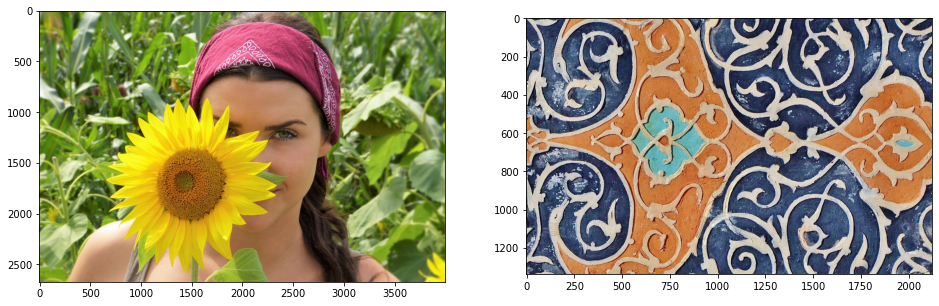

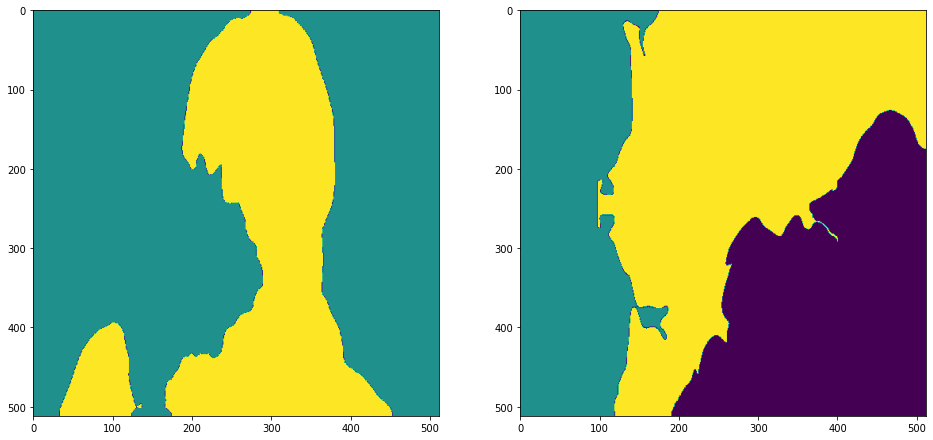

start


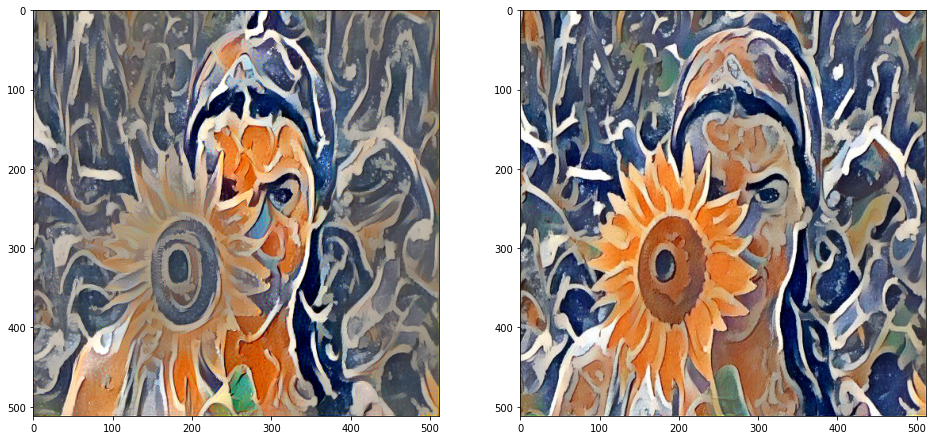

In [109]:
style = 0
content = 1
Model(content_b+str(content)+'.jpg',imgs[style], distance_imgs_gram_mse, style,style_masks_all, pr[style]+str(content)+'.jpg')

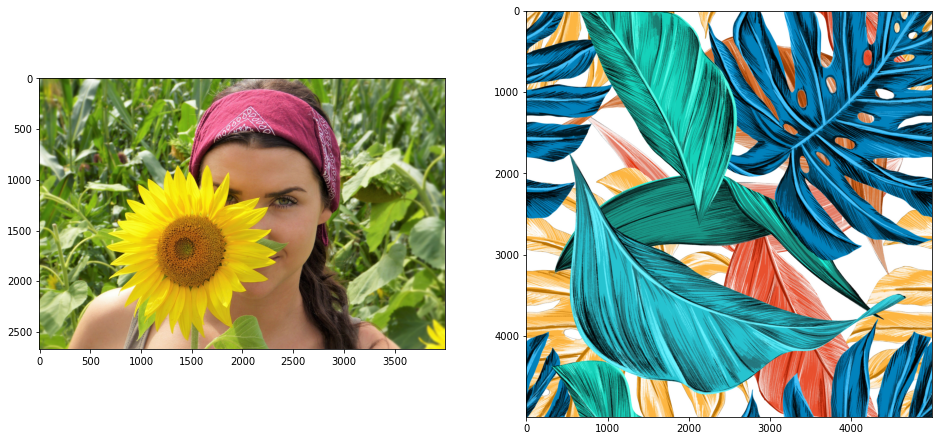

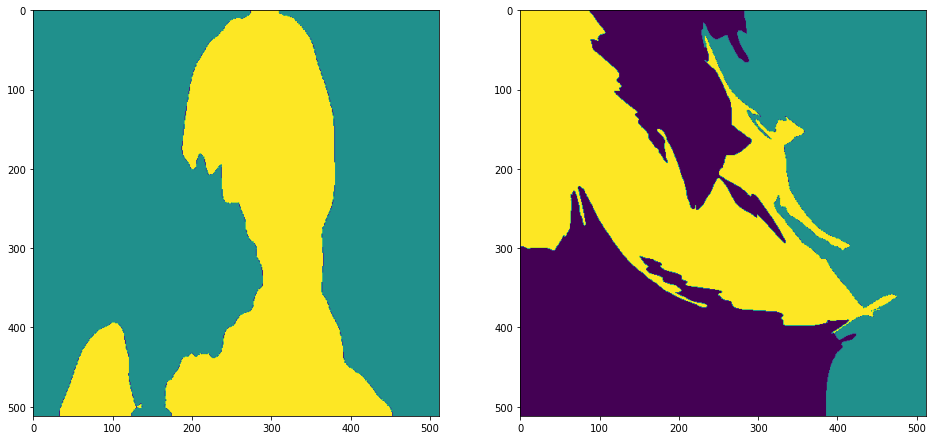

start


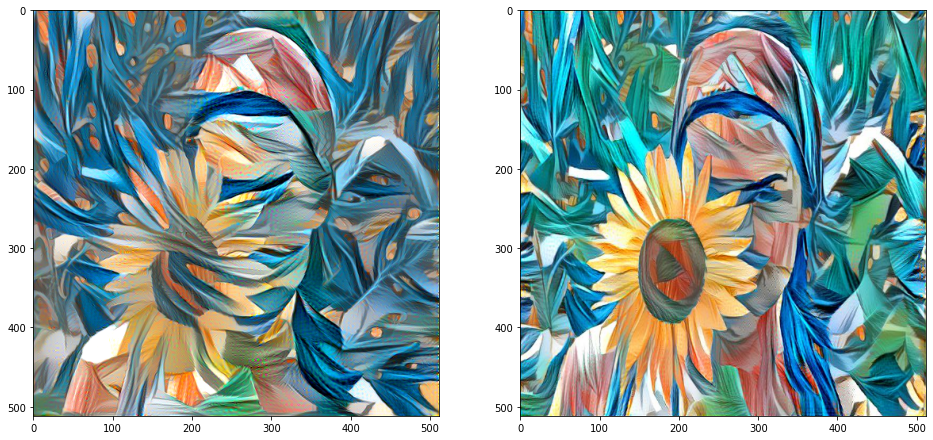

In [110]:
style = 1
content = 1
Model(content_b+str(content)+'.jpg',imgs[style], distance_imgs_gram_mse, style,style_masks_all, pr[style]+str(content)+'.jpg')

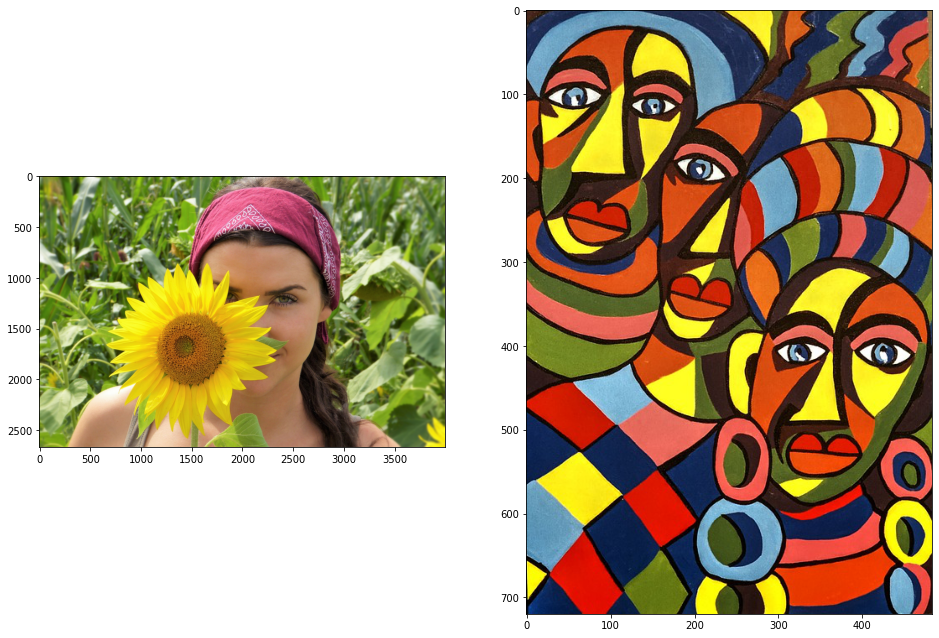

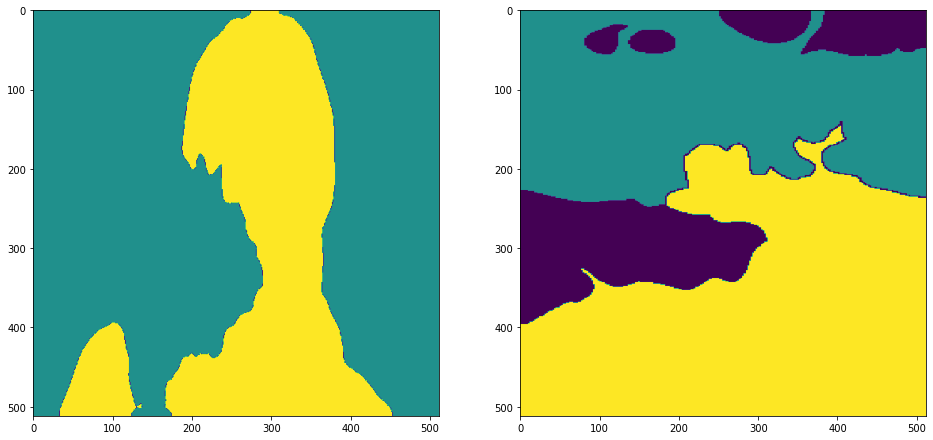

start


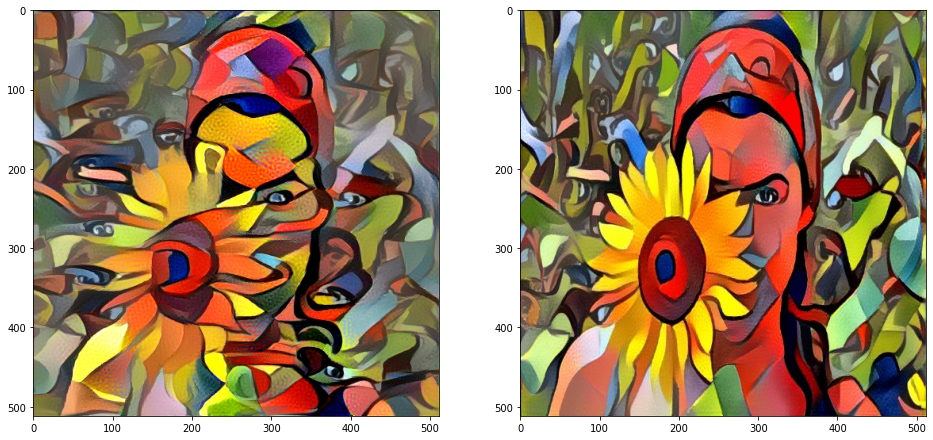

In [111]:
style = 2
content = 1
Model(content_b+str(content)+'.jpg',imgs[style], distance_imgs_gram_mse, style,style_masks_all, pr[style]+str(content)+'.jpg')

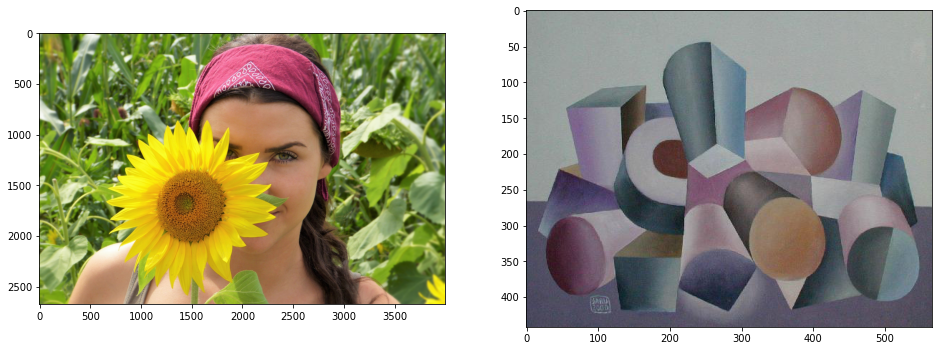

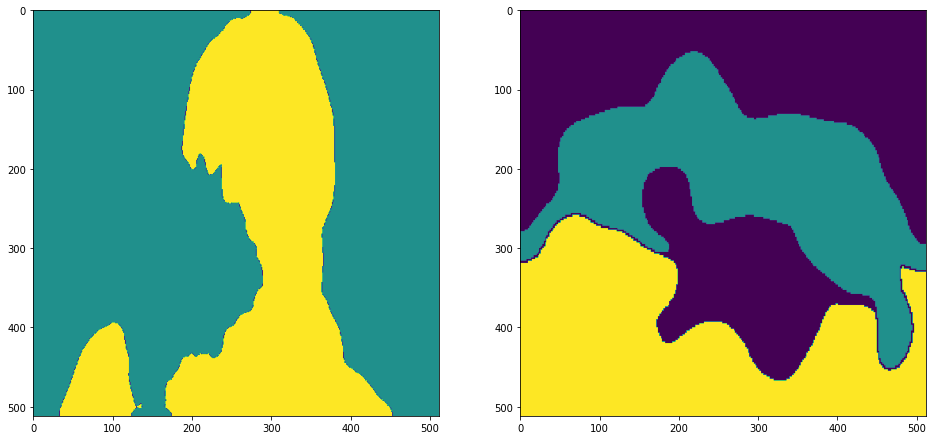

start


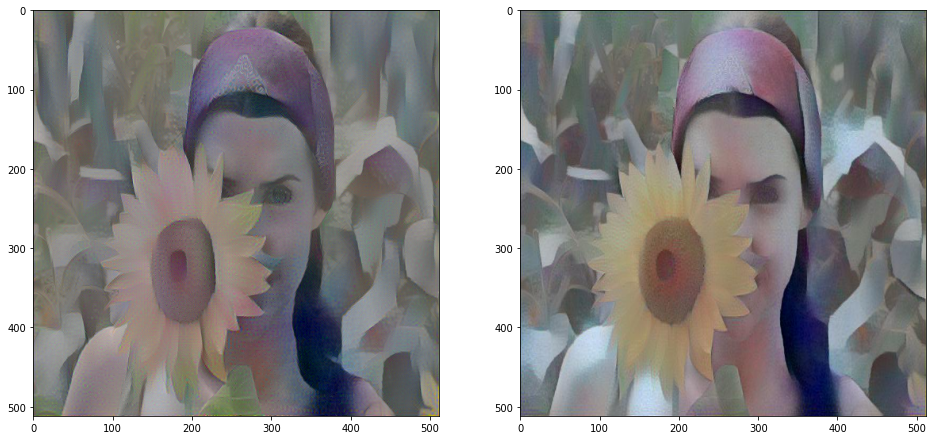

In [112]:
style = 3
content = 1
Model(content_b+str(content)+'.jpg',imgs[style], distance_imgs_gram_mse, style,style_masks_all, pr[style]+str(content)+'.jpg')

In [125]:
len(style_masks_all[style])

4

In [ ]:
style_masks_all[style]

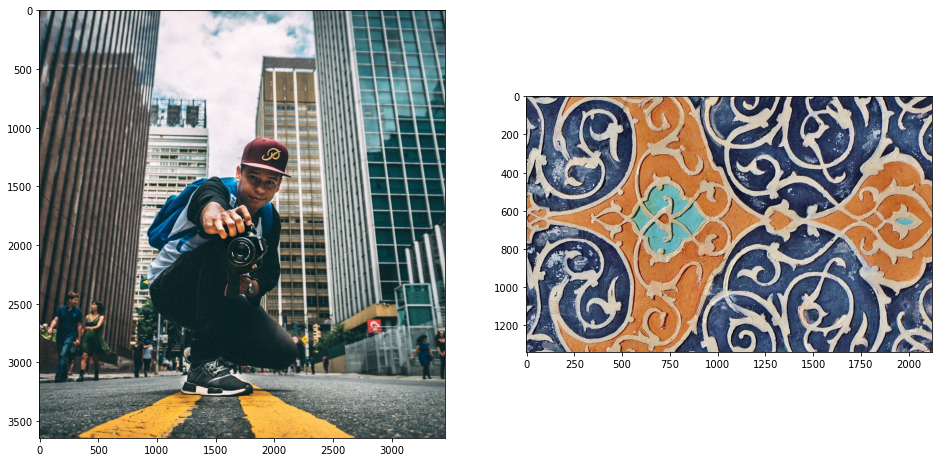

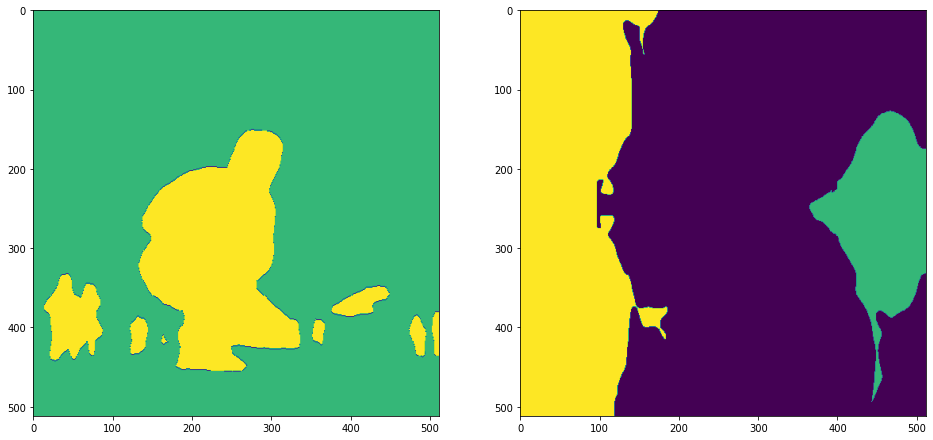

start


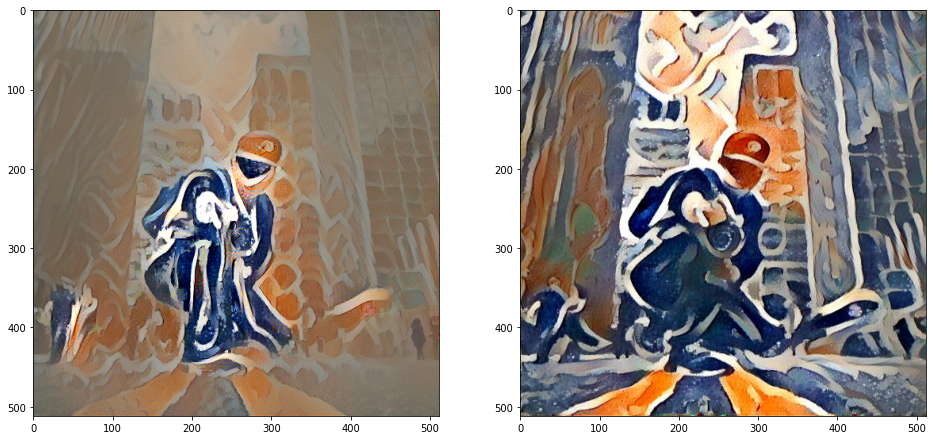

In [135]:
style = 0
content = 3
Model(content_b+str(content)+'.jpg',imgs[style], distance_imgs_gram_mse, style,style_masks_all, pr[style]+str(content)+'.jpg')

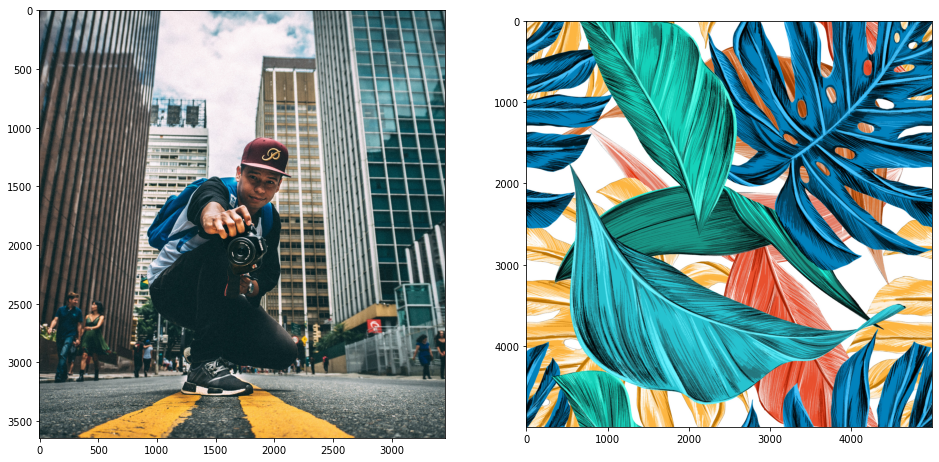

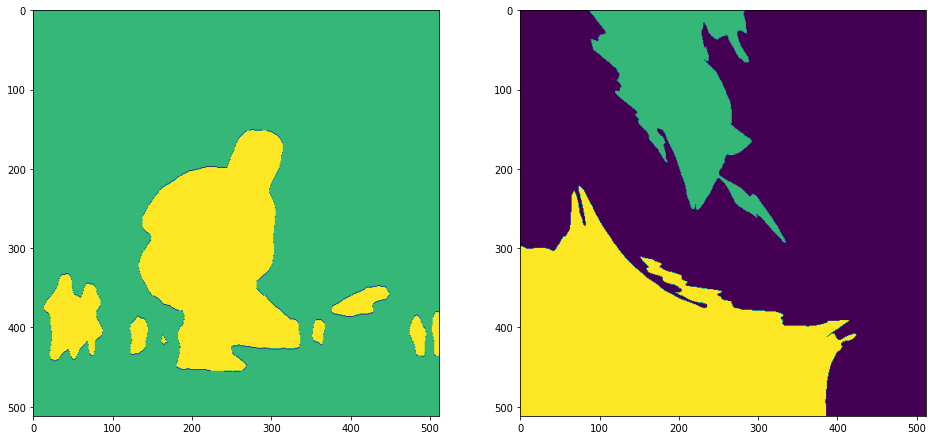

start


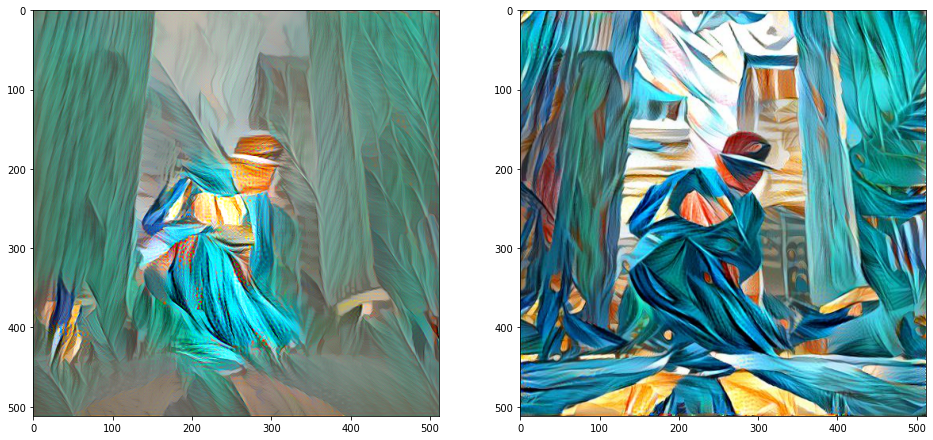

In [136]:
style = 1
content = 3
Model(content_b+str(content)+'.jpg',imgs[style], distance_imgs_gram_mse, style,style_masks_all, pr[style]+str(content)+'.jpg')

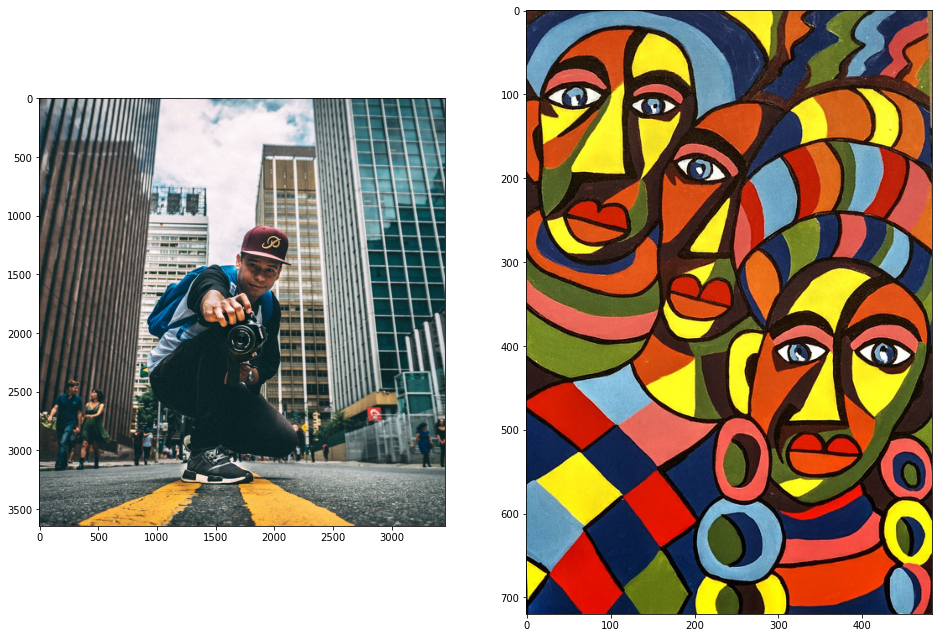

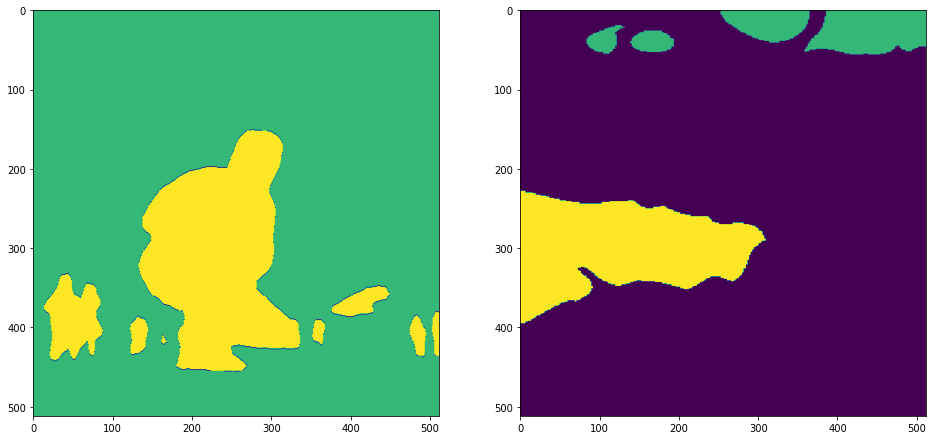

start


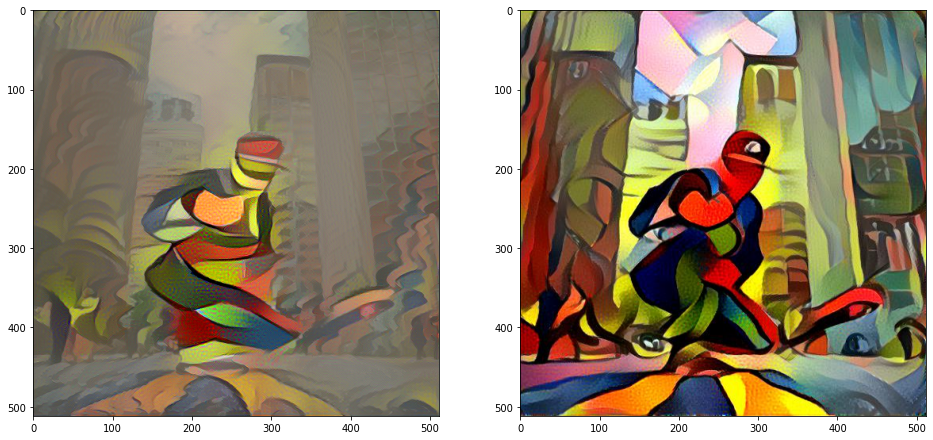

In [137]:
style = 2
content = 3
Model(content_b+str(content)+'.jpg',imgs[style], distance_imgs_gram_mse, style,style_masks_all, pr[style]+str(content)+'.jpg')

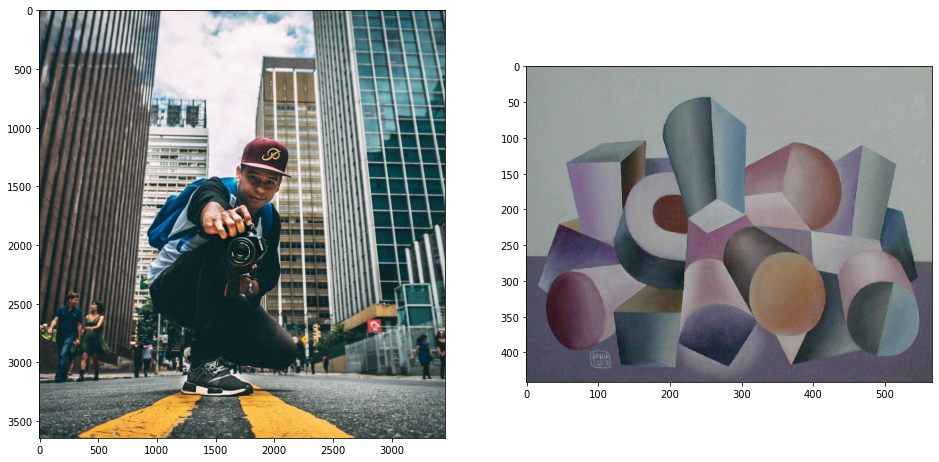

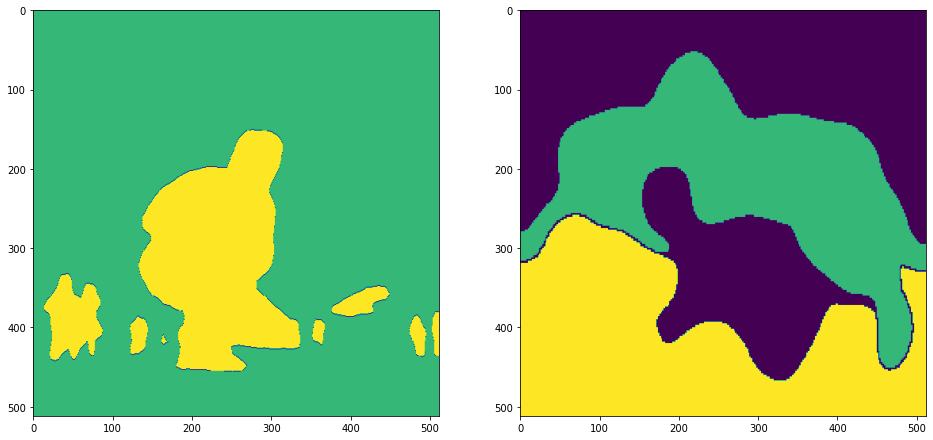

start


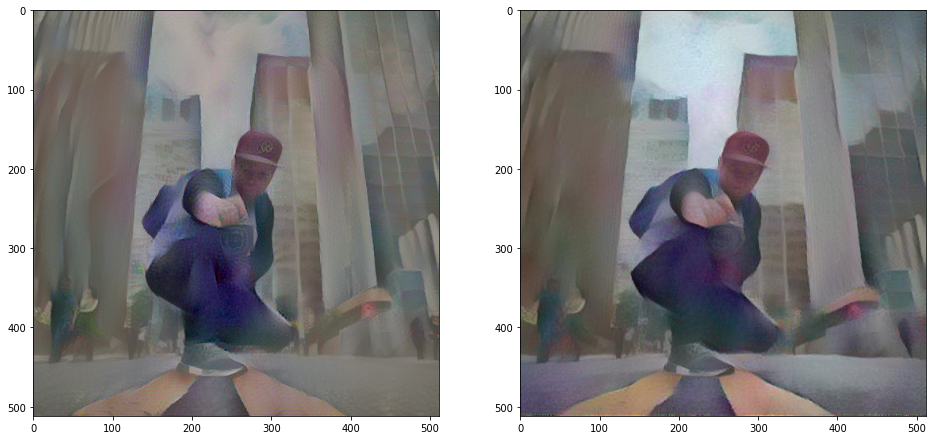

In [138]:
style = 3
content = 3
Model(content_b+str(content)+'.jpg',imgs[style], distance_imgs_gram_mse, style,style_masks_all, pr[style]+str(content)+'.jpg')

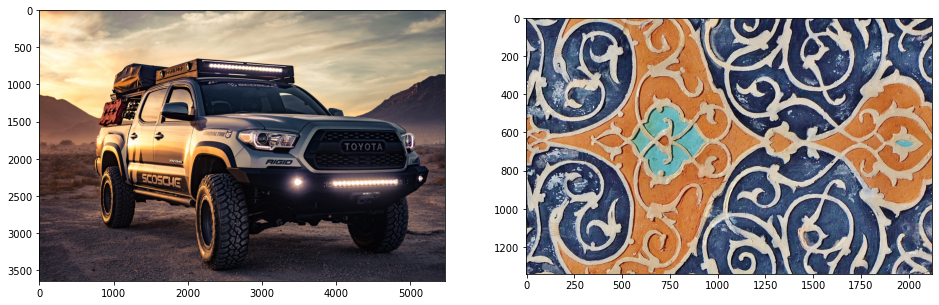

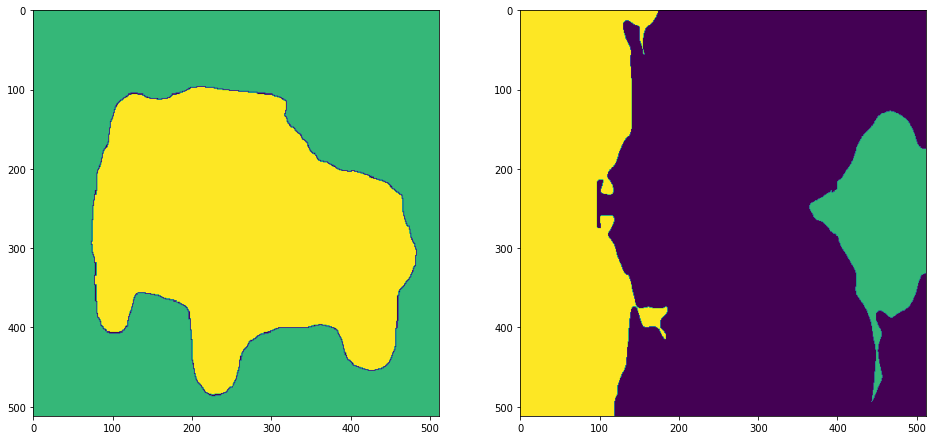

start


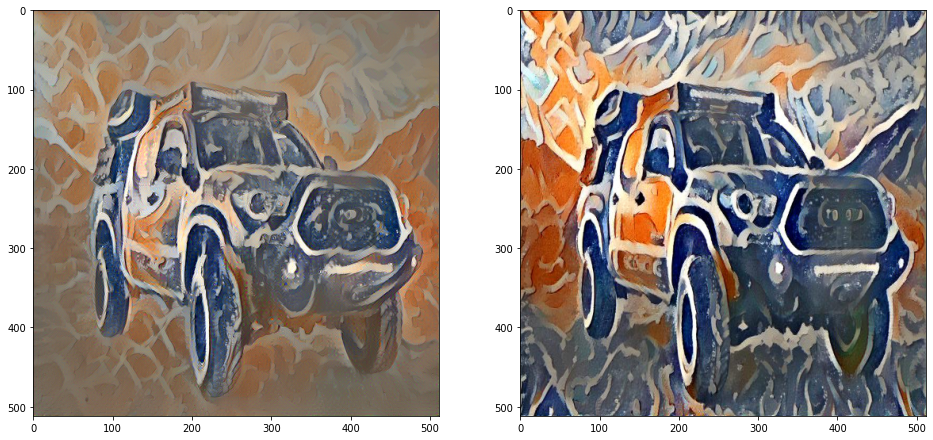

In [140]:
style = 0
content = 4
Model(content_b+str(content)+'.jpg',imgs[style], distance_imgs_gram_mse, style,style_masks_all, pr[style]+str(content)+'.jpg')

## Model 2

closeness metric - MSE between results of gram function after some layer pretrained vgg applied to grayscale img

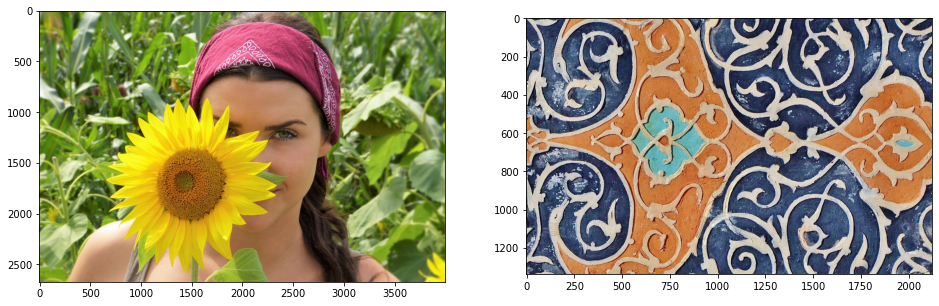

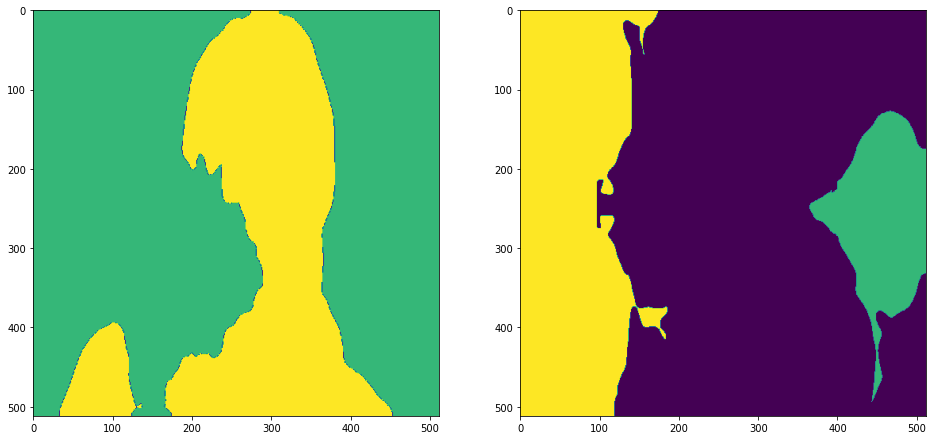

start


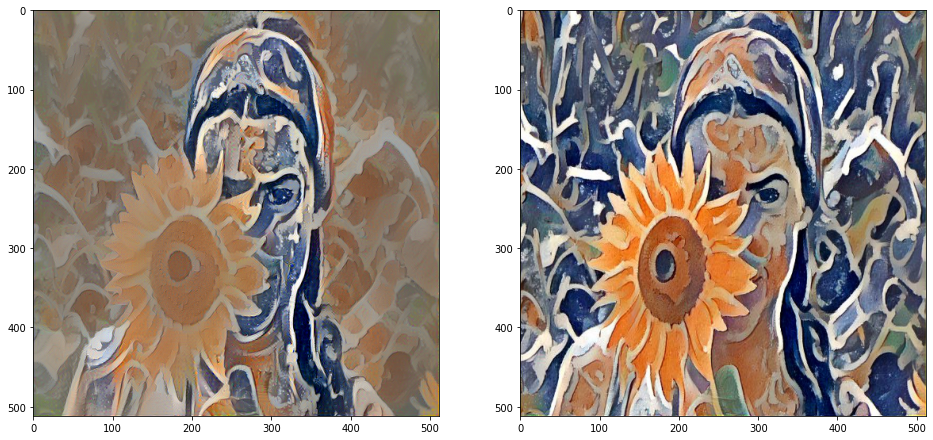

In [181]:
style = 0
content = 1
Model(content_b+str(content)+'.jpg',imgs[style], distance_imgs_gram_mse_gray, style,style_masks_all, pr[style]+str(content)+'.jpg')

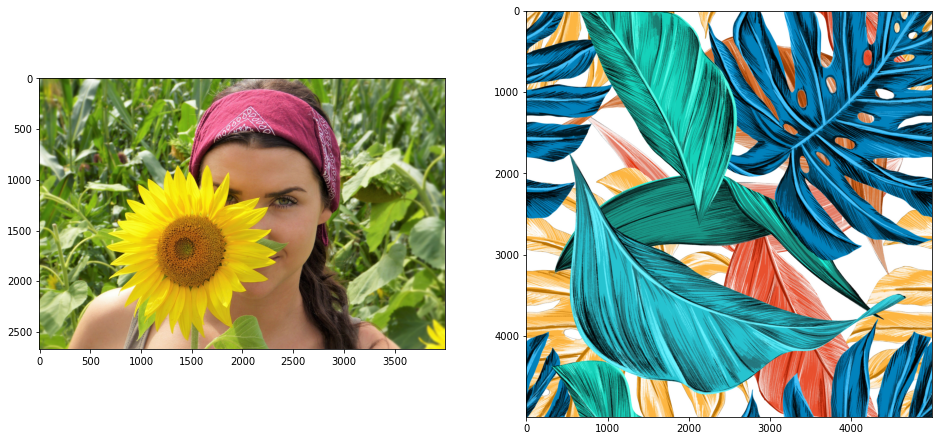

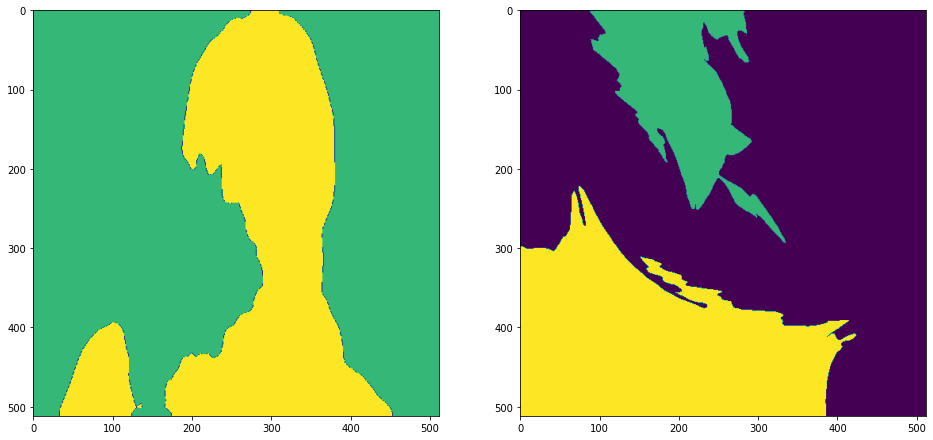

start


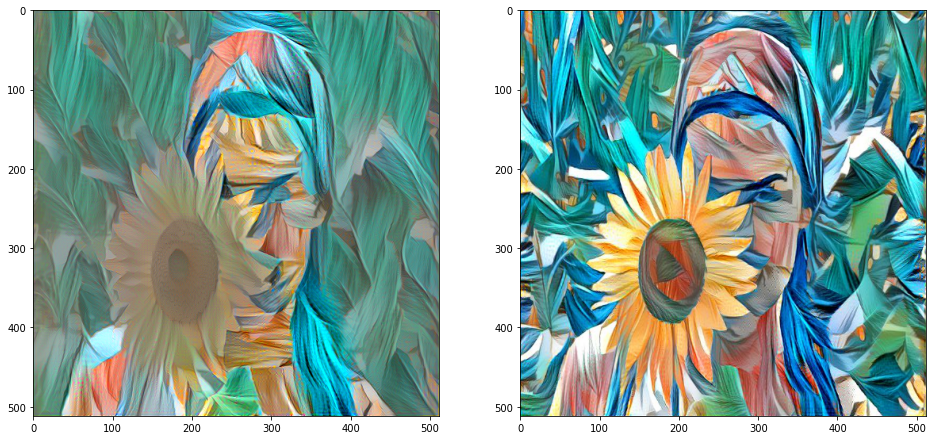

In [182]:
style = 1
content = 1
Model(content_b+str(content)+'.jpg',imgs[style], distance_imgs_gram_mse_gray, style,style_masks_all, pr[style]+str(content)+'.jpg')

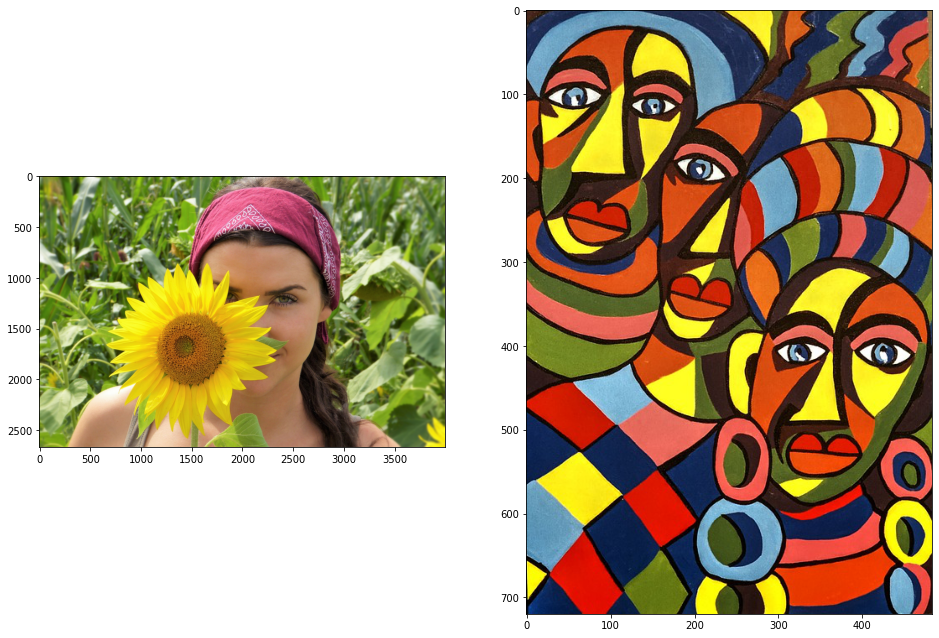

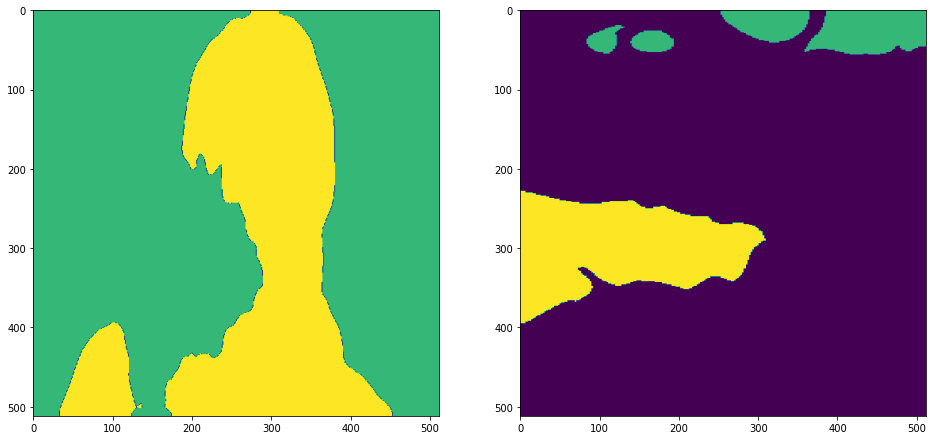

start


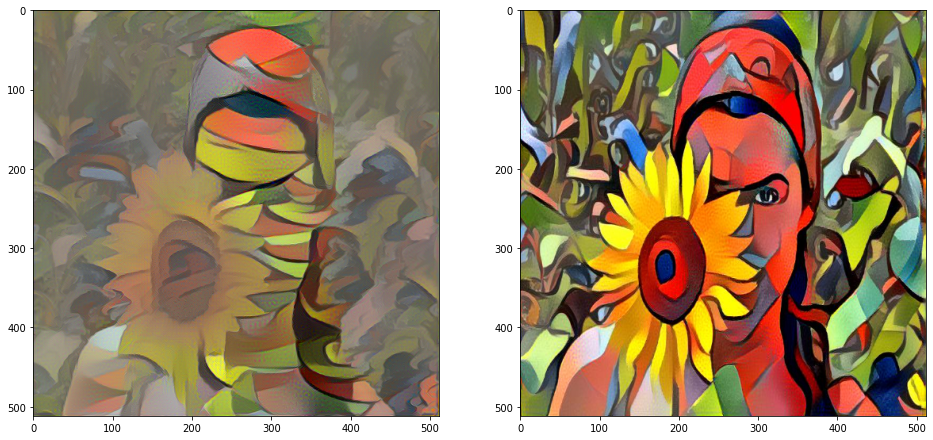

In [183]:
style = 2
content = 1
Model(content_b+str(content)+'.jpg',imgs[style], distance_imgs_gram_mse_gray, style,style_masks_all, pr[style]+str(content)+'.jpg')